In [48]:
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
from scipy.stats import spearmanr, pearsonr, mannwhitneyu

In [49]:
import matplotlib.pyplot as plt
import seaborn as sns

In [50]:
# Scanpy settings
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

celltype = 'cd4'
master_dir = '../'

scanpy==1.6.0 anndata==0.7.5 umap==0.4.6 numpy==1.19.4 scipy==1.5.4 pandas==1.1.4 scikit-learn==0.23.2 statsmodels==0.12.1 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [51]:
# Name of results file 
results_file_all_genes = master_dir + 'output/' + celltype + '-processed-analyzed.h5ad'
results_file_metab_genes = master_dir + 'output/' + celltype + '-processed-analyzed-metab.h5ad'

# Read in counts matrix
adata = sc.read_h5ad(master_dir + 'data/PBMC/fo8_thru_in8_GEX_for_CD4.h5ad')

In [52]:
adata

AnnData object with n_obs × n_vars = 52261 × 21517
    obs: 'patient', 'ICU_status', 'IL6i_between_draws', 'no_IL6i', 'WHO_scale', 'Blood_draw_time', 'Sex', 'Age_at_baseline', 'Days_since_onset_of_symptoms', 'leiden'
    uns: 'leiden_colors'
    obsm: 'X_umap'

In [53]:
adata.var_names

Index(['MIR1302-2HG', 'AL627309.1', 'AL627309.3', 'AL669831.5', 'FAM87B',
       'LINC00115', 'FAM41C', 'AL645608.3', 'SAMD11', 'NOC2L',
       ...
       'AC011043.1', 'AL592183.1', 'AC007325.1', 'AC007325.4', 'AC007325.2',
       'AL354822.1', 'AC004556.1', 'AC233755.2', 'AC233755.1', 'AC240274.1'],
      dtype='object', length=21517)

In [54]:
sum(adata.var_names.str.startswith('MT-'))

13

# Preprocessing

The gene list used was determined by filtering the initial 8 samples for genes that were expressed in 3 or more cells (per sample), then after that, every sample was just filtered for cells that expressed 200+ genes with some manual filtering of mito%, number of raw counts and number of genes, (usually like 5-10% mito, 10k raw counts, 3k genes but it varied if majority of cells all had higher or lower counts). Then just concatenated all of the samples together, split into gene expression data and protein data. Then, took the gene expression data and normalized each cell to have a count of 1e6 and then did log1p.

<u>Thus, no need to do further filtering, normalization, or log transformation below.</u>

normalizing counts per cell
    finished (0:00:02)


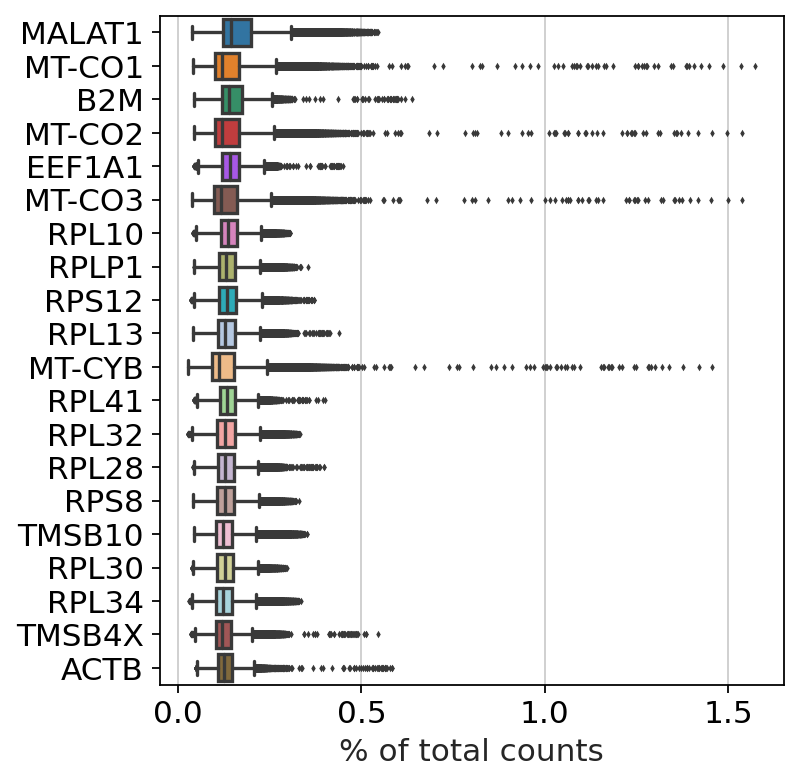

In [55]:
# Preprocessing
sc.pl.highest_expr_genes(adata, n_top=20)

# Clustering

In [56]:
# Loading in metabolics-relevant pathways from KEGG (based on Xiao et al. Nat Commun 2019)
#metab_pathway_list = pd.read_csv(master_dir + 'data/MSigDB/KEGG_metab_pathway_list_Xiao2019-JLmod200620.txt', 
#                                 sep='\t', header=None)
#metab_pathway_list = np.array(metab_pathway_list.iloc[:, 0])

# Genes in each KEGG pathway
metab_genes = pd.read_csv(master_dir + 'data/KEGG_genesets/hsa00001.metab.keg.gmt', 
                          sep='\t', header=None)
metab_genes.index = metab_genes.iloc[:, 0]
metab_genes = metab_genes.drop([0], axis=1)
#for geneset in metab_genes.index:
#    if metab_genes.loc[geneset, 1] not in metab_pathway_list:
#        metab_genes = metab_genes.drop(geneset, axis=0)
metab_pathway_list = metab_genes.index
metab_genes.head()

,1,2,3,4,5,6,7,8,9,10,...,124,125,126,127,128,129,130,131,132,133
0,,,,,,,,,,,,,,,,,,,,,
Glycolysis / Gluconeogenesis,LDHC,HK3,LDHB,PFKP,ALDOA,ALDOB,ADH6,GAPDHS,DLAT,PGM1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Citrate cycle (TCA cycle),DLST,ACO1,CS,IDH3B,ACLY,SUCLG2,DLAT,IDH3A,SUCLA2,PDHB,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pentose phosphate pathway,PFKP,ALDOA,RPIA,ALDOB,H6PD,RPE,RPEL1,PRPS1L1,PFKM,RBKS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pentose and glucuronate interconversions,UGT2B4,UGT2A1,XYLB,CRYL1,UGT2B17,UGT1A3,UGDH,UGT1A4,UGT1A8,UGP2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Fructose and mannose metabolism,HK3,PFKFB3,PFKP,FCSK,ALDOA,ALDOB,GFUS,TPI1,PMM2,SORD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [57]:
# Pathways from Xiao et al. (2019) that are not found in the gene set list
set(metab_pathway_list).difference(set(metab_genes.index))

set()

In [58]:
# Get a flat array of metabolism-related genes
metab_gene_list = np.array(metab_genes.iloc[:, 1:]).flatten().astype(str)
metab_gene_list = metab_gene_list[metab_gene_list != 'nan']
len(metab_gene_list)

2841

In [59]:
# Make a new data object with only the metabolic genes from the KEGG pathways
metab_gene_list_overlap = list(set(metab_gene_list).intersection(set(adata.var_names)))
adata_metab = adata[:, metab_gene_list_overlap]
len(metab_gene_list_overlap)

1387

In [60]:
# Convert the metabolic pathways dataframe into a dictionary for GSEA
metab_genes_dict = metab_genes.transpose().to_dict(orient='series')
for element in metab_genes_dict:
    # Only include the genes that are also found in the single cell sequencing
    metab_genes_dict[element] = list(set(metab_genes_dict[element]).intersection(set(adata.var_names)))
    #metab_genes_dict[element] = metab_genes_dict[element][metab_genes_dict[element] != 'nan']
#metab_genes_dict['Glycolysis / Glucogeneogenesis_test'] = ['ACSS1', 'GAPDH']

## First, an analysis with all of the filtered genes (not just metabolic)

In [22]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    with n_comps=50
    finished (0:01:07)


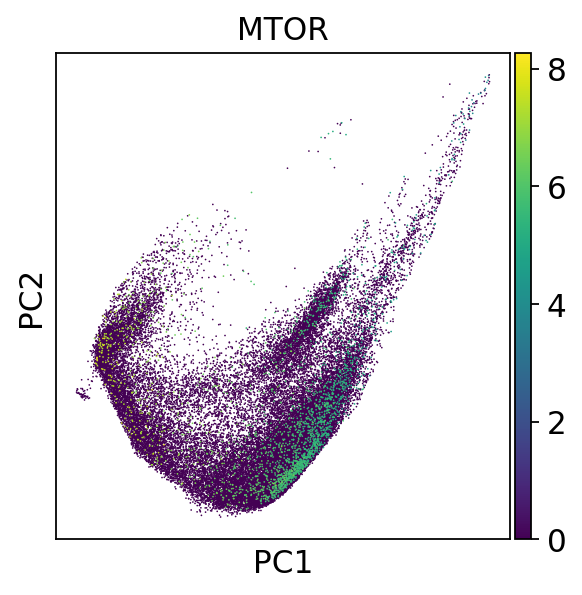

In [23]:
fig = sc.pl.pca(adata, color='MTOR')#, title='CD4+ cells clustered by all genes')

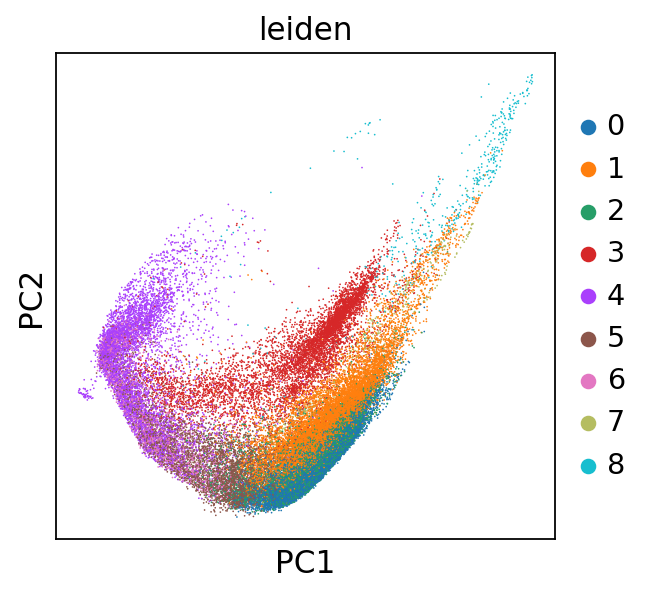

In [25]:
fig = sc.pl.pca(adata, color='leiden')#, title='CD4+ cells clustered by all genes')

In [26]:
#sc.tl.paga(adata, groups='louvain')

In [27]:
#sc.pl.paga(adata, color=['louvain', 'HIF1A', 'MYC', 'MTOR'])

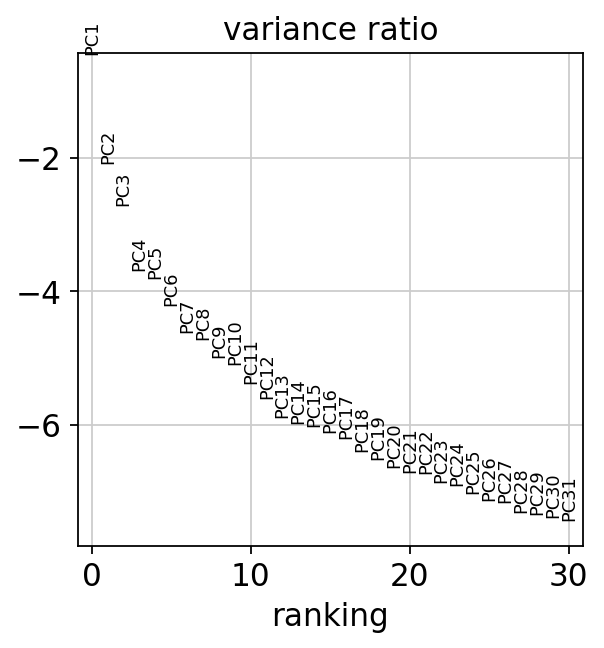

In [28]:
sc.pl.pca_variance_ratio(adata, log=True)

In [29]:
sc.pp.neighbors(adata)
#sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:19)


In [30]:
#sc.tl.leiden(adata, resolution=0.1)

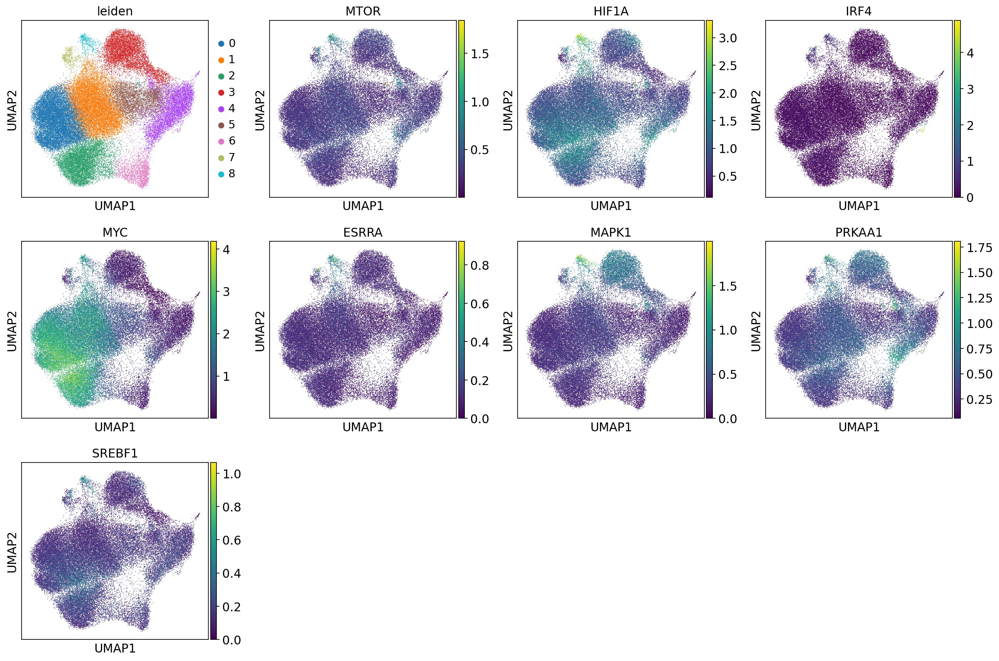

In [14]:
#fig = sc.pl.umap(adata, color=['louvain', 'MTOR', 'HIF1A', 'MYC', 
#                               'AKT1', 'ESRRA', 'RHOA', 'SREBF1',
#                              'ICOS', 'BCL6', 'PPARGC1A', 'IRF4', 'PRKAA1'], use_raw=False)
fig = sc.pl.umap(adata, color=['leiden', 'MTOR', 'HIF1A', 'IRF4', 'MYC', 'ESRRA', 'MAPK1', 'PRKAA1', 'SREBF1'], 
                 use_raw=False)

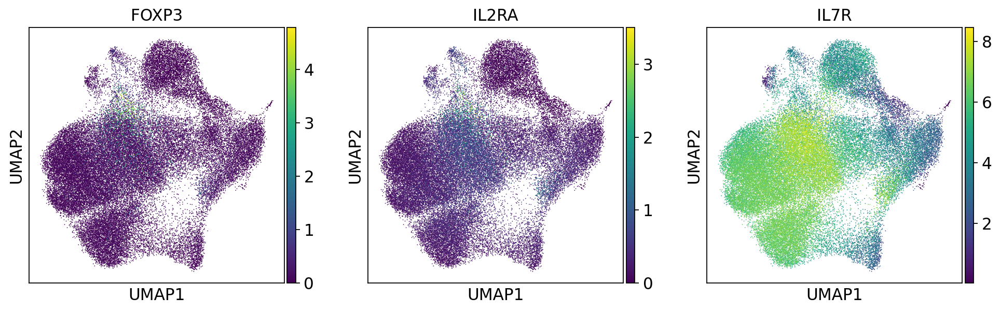

In [15]:
#Treg manual gating: FoxP3+ CD25+ (high IL2RA) CD127dim (low IL7R).
fig = sc.pl.umap(adata, color=['FOXP3', 'IL2RA', 'IL7R'], cmap='viridis', use_raw=False)

<b>Gating Treg, Tfh, Th17</b>

<Figure size 320x320 with 0 Axes>

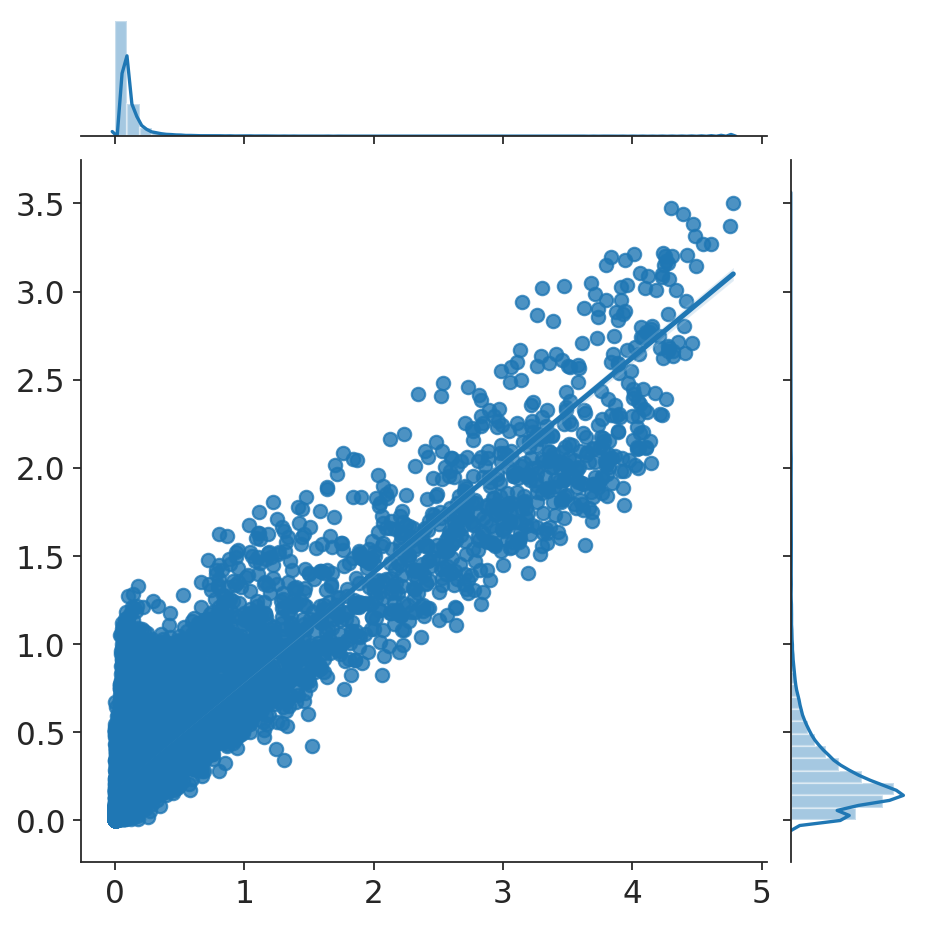

In [16]:
sns.set_style('white')
sns.set_style('ticks')
#f, axes = plt.subplots(1, 2, figsize=(20, 8), sharex=True, sharey=False)
sns.despine()

fig = sns.JointGrid(x=adata.X[:, np.where(adata.var_names=='FOXP3')].flatten(), 
                      y=adata.X[:, np.where(adata.var_names=='IL2RA')].flatten())
fig = fig.plot(sns.regplot, sns.distplot)
#sns.plt.ylim(0, 20)
#fig = sns.scatterplot(x=adata.X[:, np.where(adata.var_names=='FOXP3')].flatten(), 
#                      y=adata.X[:, np.where(adata.var_names=='IL7R')].flatten(), 
#                     hue=adata.obs['leiden'], size=0.5, legend=None, ax=axes[1])

#fig.legend_.remove()

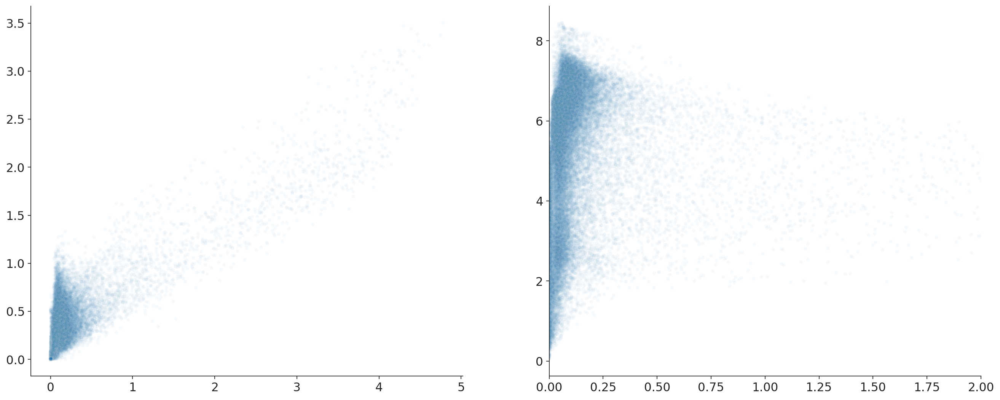

In [30]:
# Treg
sns.set_style('white')
sns.set_style('ticks')
f, axes = plt.subplots(1, 2, figsize=(20, 8), sharex=False, sharey=False)
sns.despine()

fig = plt.xlim(0, 2)
fig = sns.scatterplot(x=adata.X[:, np.where(adata.var_names=='FOXP3')].flatten(), 
                      y=adata.X[:, np.where(adata.var_names=='IL2RA')].flatten(), 
                     alpha=0.03, size=0.5, legend=None, ax=axes[0])

fig = sns.scatterplot(x=adata.X[:, np.where(adata.var_names=='FOXP3')].flatten(), 
                      y=adata.X[:, np.where(adata.var_names=='IL7R')].flatten(), 
                     alpha=0.03, size=0.5, legend=None, ax=axes[1])

In [37]:
# Manual gating for Tregs: based on the above,
# FOXP3 > 0.5, IL2RA > 0.25, IL7R < 5
adata.obs['subtype'] = 'unknown'
adata.obs.iloc[np.where((adata.X[:, np.where(adata.var_names=='FOXP3')].flatten() > 0.5)
                       * (adata.X[:, np.where(adata.var_names=='IL2RA')].flatten() > 0.25)
                       * (adata.X[:, np.where(adata.var_names=='IL7R')].flatten() < 5.0))[0], 
              np.where(adata.obs.columns=='subtype')[0]] = 'Treg'

In [38]:
sum(adata.obs['subtype']=='Treg')

1331

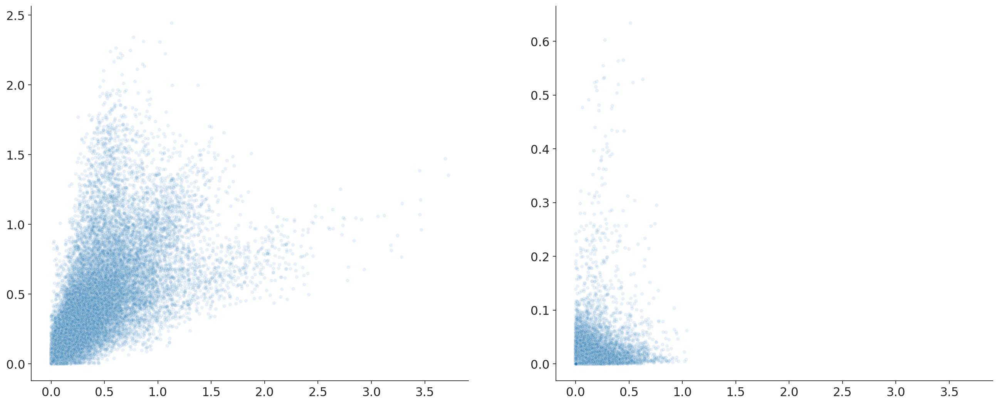

In [39]:
# Th17
# IL-17A/F are not found in the gene list
sns.set_style('white')
sns.set_style('ticks')
f, axes = plt.subplots(1, 2, figsize=(20, 8), sharex=True, sharey=False)
sns.despine()

fig = sns.scatterplot(x=adata.X[:, np.where(adata.var_names=='CCR4')].flatten(), 
                      y=adata.X[:, np.where(adata.var_names=='CCR6')].flatten(), 
                     alpha=0.1, size=0.5, legend=None, ax=axes[0])

fig = sns.scatterplot(x=adata.X[:, np.where(adata.var_names=='RORC')].flatten(), 
                      y=adata.X[:, np.where(adata.var_names=='IL22')].flatten(), 
                     alpha=0.1, size=0.5, legend=None, ax=axes[1])

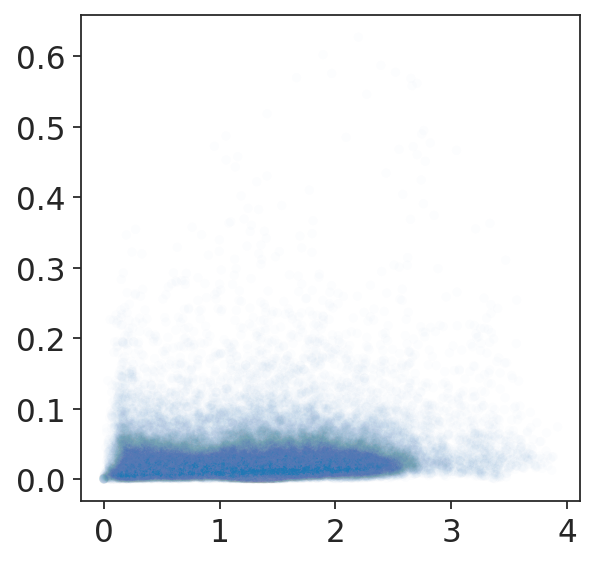

In [40]:
# Tfh
sns.set_style('white')
sns.set_style('ticks')
sns.despine()

fig = sns.scatterplot(x=adata.X[:, np.where(adata.var_names=='CD4')].flatten(), 
                      y=adata.X[:, np.where(adata.var_names=='BCL6')].flatten(), 
                     alpha=0.01, size=0.5, legend=None)

/usr/lusers/jlee712/anaconda3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'subtype' as categorical


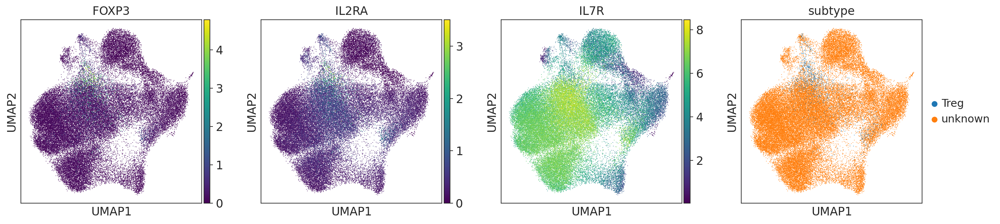

In [41]:
#Treg manual gating: FoxP3+ CD25+ (high IL2RA) CD127dim (low IL7R). (not done)
fig = sc.pl.umap(adata, color=['FOXP3', 'IL2RA', 'IL7R', 'subtype'], cmap='viridis', use_raw=False)

In [42]:
sum(adata.obs['subtype']=='Treg')

1331

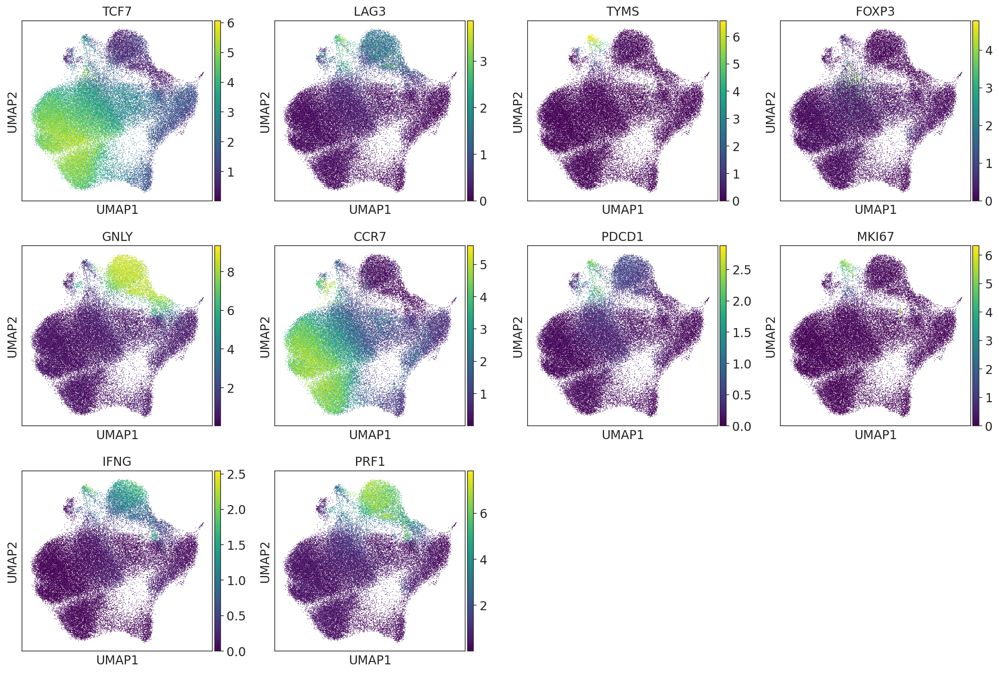

In [43]:
fig = sc.pl.umap(adata, color=['TCF7', 'LAG3', 'TYMS', 'FOXP3', 'GNLY', 'CCR7', 'PDCD1', 
                               'MKI67', 'IFNG', 'PRF1'], cmap='viridis', use_raw=False)
# CD98 (SLC3A2) found in cells with high glycolytic activity
# GLUT1 (SLC2A1) upregulates glycolysis
# 4-1BB (TNFRSF9) upregulates FAO and glycolysis
# DNM1L induces mitochondrial fragmentation in effector cells

In [44]:
adata.obs['Days_since_onset_float'] = adata.obs['Days_since_onset_of_symptoms'].apply(lambda x:float(x) if x!= 'Healthy' else -1).astype(float)

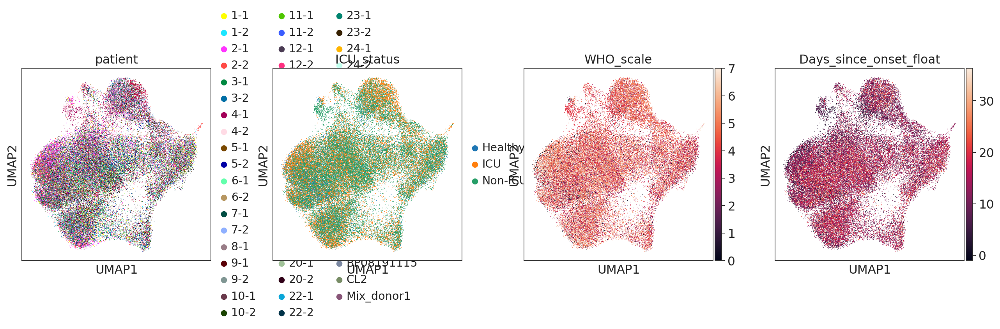

In [45]:
fig = sc.pl.umap(adata, color=['patient', 'ICU_status', 'WHO_scale', 'Days_since_onset_float'], use_raw=False)

In [46]:
sc.tl.embedding_density(adata, basis='umap', groupby='ICU_status')

computing density on 'umap'
--> added
    'umap_density_ICU_status', densities (adata.obs)
    'umap_density_ICU_status_params', parameter (adata.uns)


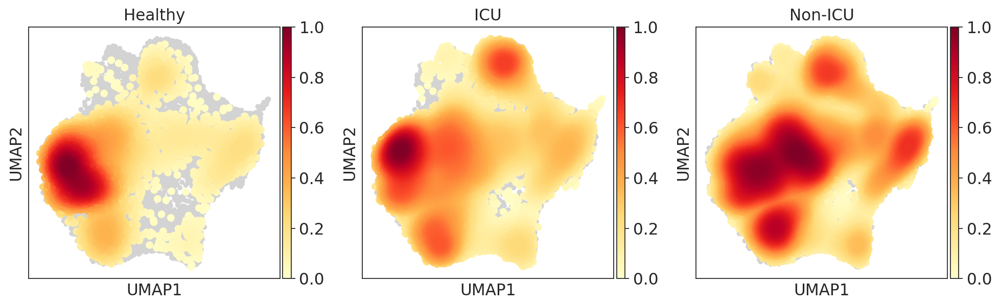

In [47]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_ICU_status')

ranking genes


/usr/lusers/jlee712/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:04:37)


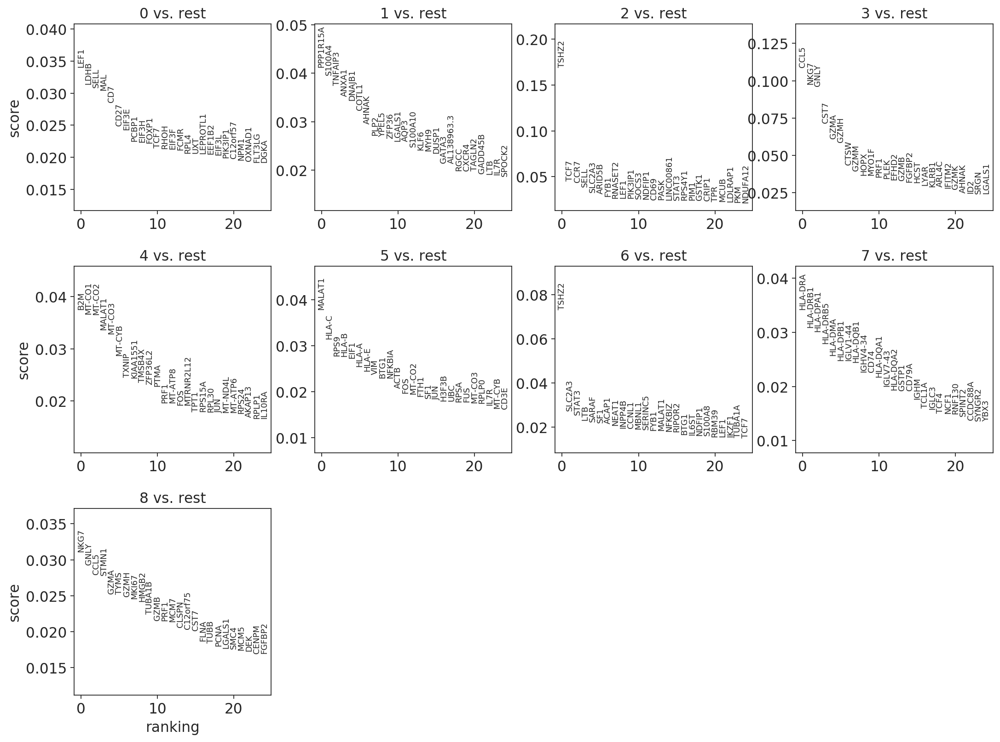

In [50]:
# Finding top genes per leiden cluster
sc.tl.rank_genes_groups(adata, 'leiden', method='logreg', use_raw=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [59]:
# Show the above ranked genes in table format
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6,7,8
0,LEF1,PPP1R15A,TSHZ2,CCL5,B2M,MALAT1,TSHZ2,HLA-DRA,NKG7
1,LDHB,S100A4,TCF7,NKG7,MT-CO1,HLA-C,SLC2A3,HLA-DRB1,GNLY
2,SELL,TNFAIP3,CCR7,GNLY,MT-CO2,RPS9,STAT3,HLA-DPA1,CCL5
3,MAL,ANXA1,SELL,CST7,MALAT1,HLA-B,LTB,HLA-DRB5,STMN1
4,CD7,DNAJB1,SLC2A3,GZMA,MT-CO3,EIF1,SARAF,HLA-DMA,GZMA


## Analysis with metabolic pathway genes only

In [60]:
sc.tl.pca(adata_metab, svd_solver='arpack')

computing PCA
    with n_comps=50
    finished (0:00:03)


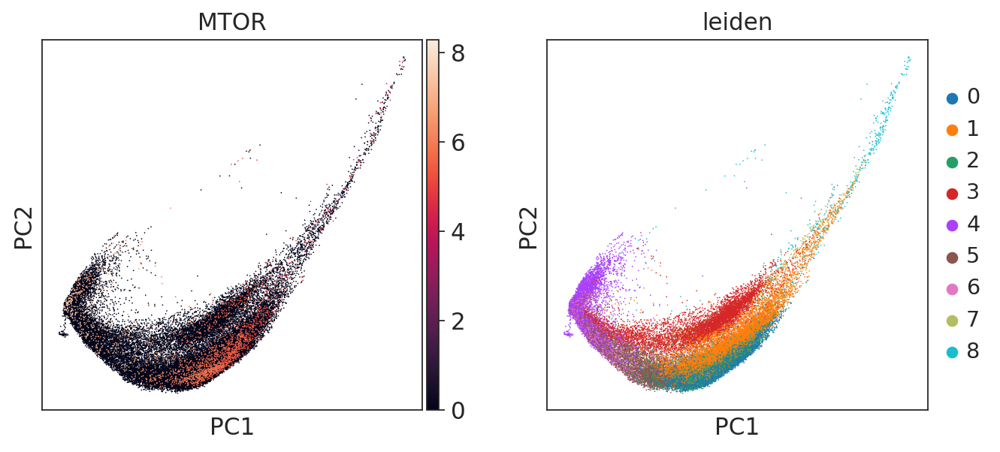

In [61]:
# Before running the next cell, this 'louvain' coloring will be by overall cluster
fig = sc.pl.pca(adata_metab, color=['MTOR', 'leiden'])#, title='CD4+ cells clustered by all genes')

In [62]:
sc.pp.neighbors(adata_metab)
sc.tl.umap(adata_metab)
sc.tl.louvain(adata_metab, resolution=0.1)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:01)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:08)


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:21)


/usr/lusers/jlee712/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


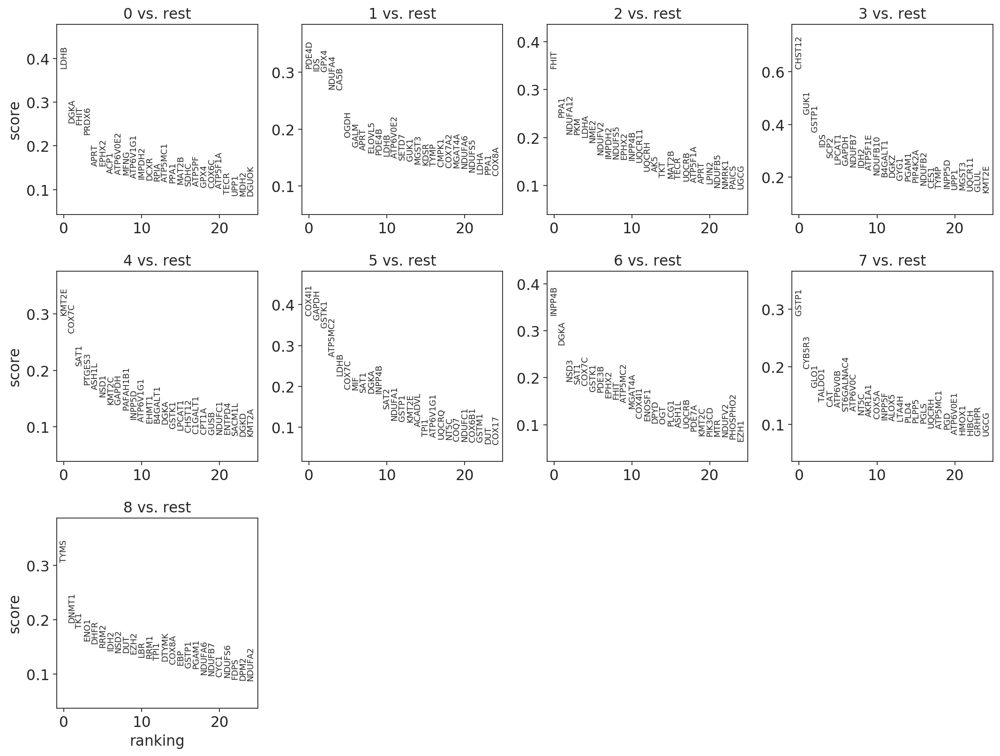

In [64]:
# Finding top genes per leiden cluster
sc.tl.rank_genes_groups(adata_metab, 'leiden', method='logreg', use_raw=False)
sc.pl.rank_genes_groups(adata_metab, n_genes=25, sharey=False)

In [65]:
# Show the above ranked genes in table format
pd.DataFrame(adata_metab.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6,7,8
0,LDHB,PDE4D,FHIT,CHST12,KMT2E,COX4I1,INPP4B,GSTP1,TYMS
1,DGKA,IDS,PPA1,GUK1,COX7C,GAPDH,DGKA,CYB5R3,DNMT1
2,FHIT,GPX4,NDUFA12,GSTP1,SAT1,GSTK1,NSD3,GLO1,TK1
3,PRDX6,NDUFA4,PKM,IDS,PTGES3,ATP5MC2,SAT1,TALDO1,ENO1
4,APRT,CA5B,LDHA,SCP2,ASH1L,LDHB,COX7C,CAT,DHFR


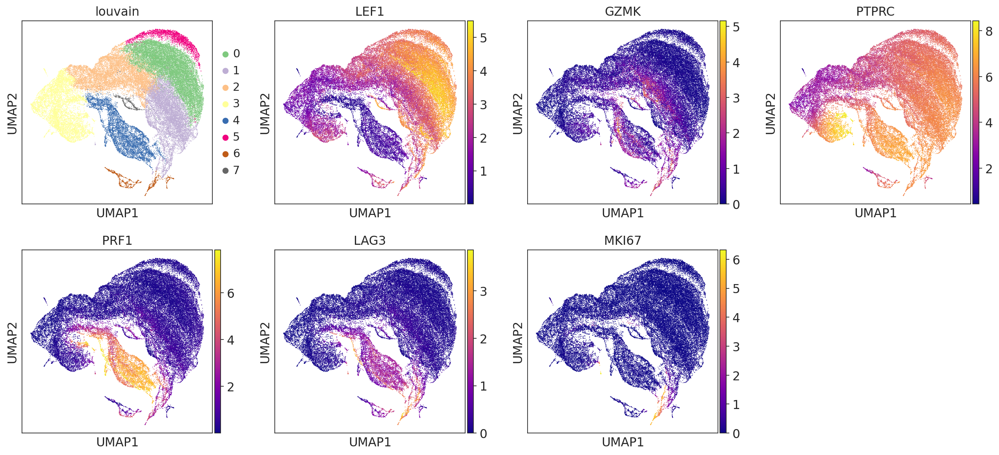

In [74]:
adata_metab_all_genes = adata.copy()
adata_metab_all_genes.obs = adata_metab.obs.copy()
adata_metab_all_genes.uns = adata_metab.uns.copy()
adata_metab_all_genes.obsm = adata_metab.obsm.copy()
fig = sc.pl.umap(adata_metab_all_genes, color=['louvain', 'LEF1', 'GZMK',
                        'PTPRC', 'PRF1', 'LAG3', 'MKI67'], cmap='plasma', use_raw=False)

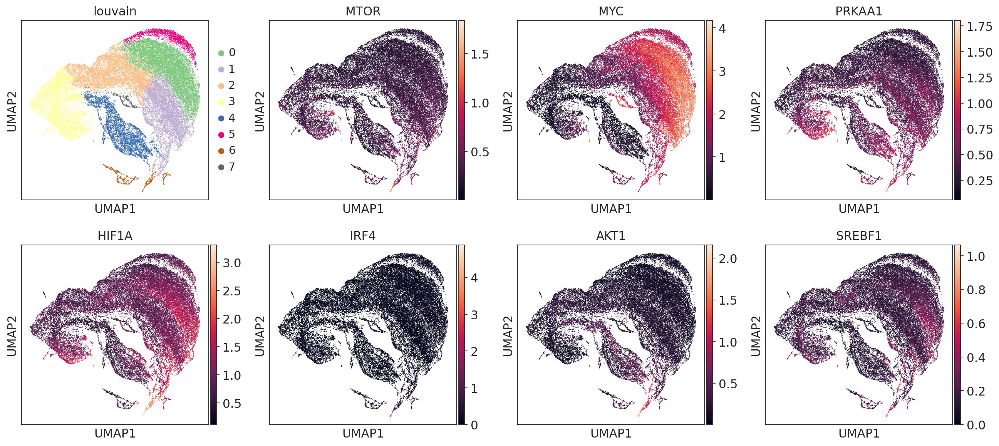

In [75]:
fig = sc.pl.umap(adata_metab_all_genes, color=['louvain', 'MTOR', 'MYC', 'ESRRA',
                        'HIF1A', 'SREBF1', 'AKT1', 'SREBF1'], use_raw=False)

In [69]:
adata_metab.obs['Days_since_onset_float'] = adata_metab.obs['Days_since_onset_of_symptoms'].apply(lambda x:float(x) if x!= 'Healthy' else -1).astype(float)

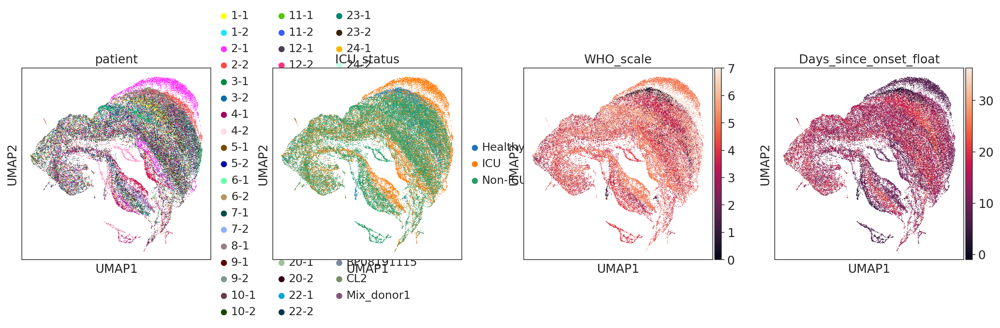

In [70]:
fig = sc.pl.umap(adata_metab, color=['patient', 'ICU_status', 'WHO_scale', 'Days_since_onset_float'], use_raw=False)

computing density on 'umap'
--> added
    'umap_density_ICU_status', densities (adata.obs)
    'umap_density_ICU_status_params', parameter (adata.uns)


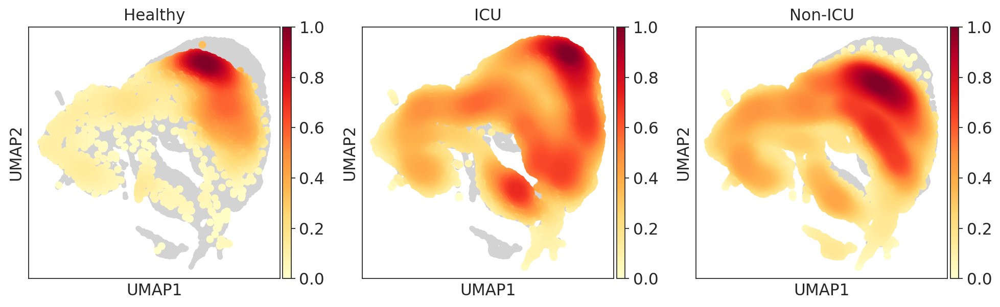

In [71]:
sc.tl.embedding_density(adata_metab, basis='umap', groupby='ICU_status')
sc.pl.embedding_density(adata_metab, basis='umap', key='umap_density_ICU_status')

# Saving data
1. Metabolic gene list
2. Cluster data with all genes
3. Cluster data with metabolic genes

In [72]:
# This was already saved from the file 'CD4-clustering.ipynb'
# Metabolic gene list
#metab_gene_file = open(master_dir + 'output/hsa0001.metab-genes.txt', 'w')
#for gene in metab_gene_list:
#    metab_gene_file.write(gene + '\n')
#metab_gene_file.close()

In [73]:
# Cluster data with all genes
#adata.write(results_file_all_genes)

In [74]:
# Cluster data with metabolic genes
#adata_metab.write(results_file_metab_genes)

# More analysis

In [61]:
# Read in the processed counts matrix
adata = sc.read_h5ad(results_file_all_genes)
adata_metab = sc.read_h5ad(results_file_metab_genes)

In [62]:
adata

AnnData object with n_obs × n_vars = 52261 × 21517
    obs: 'patient', 'ICU_status', 'IL6i_between_draws', 'no_IL6i', 'WHO_scale', 'Blood_draw_time', 'Sex', 'Age_at_baseline', 'Days_since_onset_of_symptoms', 'leiden', 'subtype', 'Days_since_onset_float', 'umap_density_ICU_status'
    uns: 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'subtype_colors', 'umap_density_ICU_status_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [63]:
adata_metab.obs['leiden_all'] = adata.obs['leiden']

In [64]:
adata.obs['louvain_metab'] = adata_metab.obs['louvain']

In [65]:
# Function for stacked bar plots to compare metabolic and all-gene clusters
def plot_bar(adata, x, y, df, kind, out, ax=None, stacked=True, colors=None, \
    rotation=0, xorder=None, yorder=None, cmap=None, **kwargs):

    if kind=='Frequency':
        props = df.groupby(x)[y].value_counts(normalize=True).unstack()
    elif kind=='Count':
        props = df.groupby(x)[y].value_counts(normalize=False).unstack()

    if xorder is not None:
        props = props.loc[xorder]
    if yorder is not None:
        props = props.loc[:, yorder]
    # stacked barplot
    with sns.axes_style('ticks'):
        if cmap is not None:
            colors = [cmap[col] for col in props.columns]
        elif y+'_colors' in adata.uns:
            palette = adata.uns[y+'_colors']
            categories = adata.obs[y].cat.categories
            cmap = {cat:color for cat, color in zip(categories, palette)}
            colors = [cmap[cat] for cat in props.columns]
        if stacked:
            ax = props.plot(kind='bar', stacked='True', color=colors, ax=ax, **kwargs)
        else:
            ax = props.plot(kind='bar', stacked=None, color=colors, ax=ax, **kwargs)
        ax.legend(bbox_to_anchor=(1.2,0.8))
        sns.despine()
        ax.set_ylabel(kind)
        ax.set_xlabel(x)
        ax.tick_params(axis='x', which='major', labelrotation=rotation)
        fig = ax.get_figure()
        fig.savefig('{}/{}_{}_{}{}.pdf'.format(out, x,y,kind, '_stacked'*stacked), \
            bbox_inches='tight', transparent=True)
        plt.close()
    return 

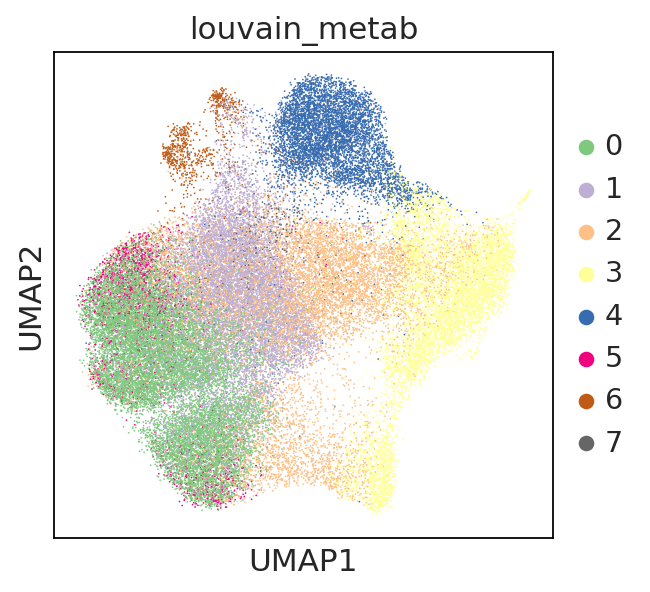

In [66]:
sc.pl.umap(adata, color='louvain_metab', palette='Accent')

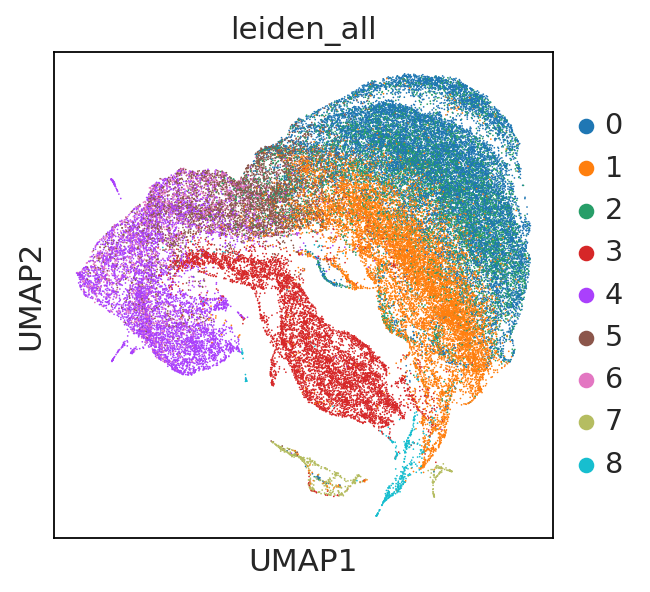

In [67]:
fig = sc.pl.umap(adata_metab, color=['leiden_all'], use_raw=False)

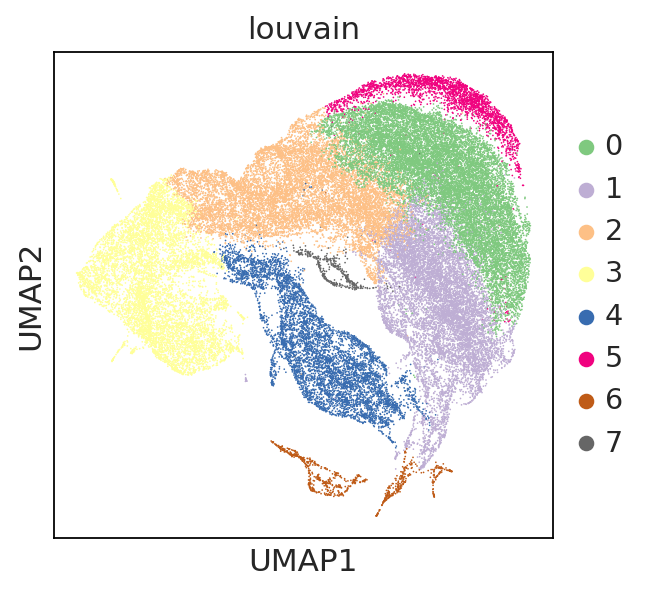

In [68]:
sc.pl.umap(adata_metab, color='louvain', palette='Accent')

In [69]:
# New in revision
adata.obs['severity'] = ['Severe' if x > 4 else 'Moderate' if x > 2 else 'Mild/healthy' 
                         for x in adata.obs['WHO_scale']]
#plot_bar(adata, 'severity', 'louvain_metab', 
#         adata.obs, 
#         'Frequency', master_dir + 'output/' + celltype + '-metab_clusters')

In [83]:
plot_bar(adata, 'leiden', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [84]:
plot_bar(adata, 'WHO_scale', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [85]:
plot_bar(adata, 'ICU_status', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters',
         xorder=['Healthy', 'Non-ICU', 'ICU'])

In [86]:
plot_bar(adata, 'no_IL6i', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [87]:
plot_bar(adata, 'WHO_scale', 'leiden', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [88]:
plot_bar(adata, 'ICU_status', 'leiden', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters',
         xorder=['Healthy', 'Non-ICU', 'ICU'])

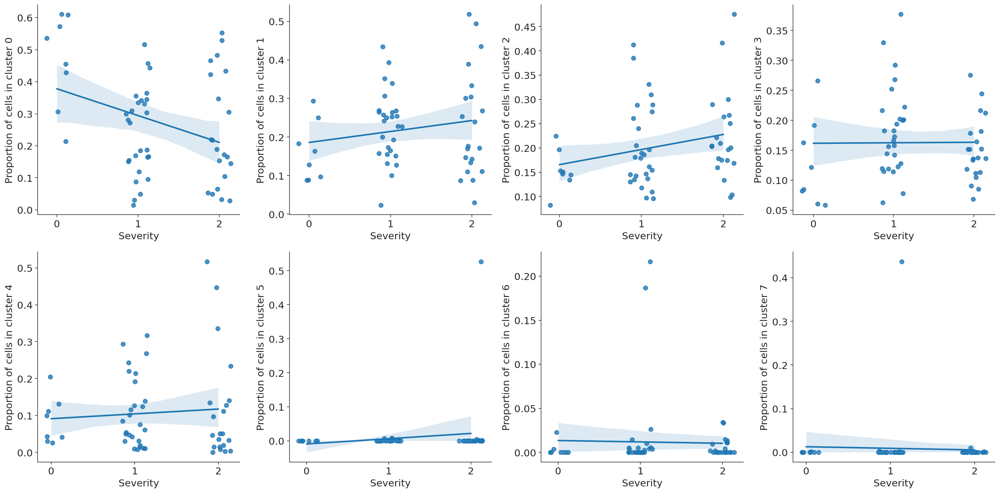

In [14]:
# Plot the top corresponding ones
sns.set_style('white')
sns.set_style('ticks')
f, axes = plt.subplots(2, 4, figsize=(20, 10), sharex=False, sharey=False)
sns.despine()

k = 0
x = adata.obs.groupby('patient').first()['severity'].map({'Mild/healthy': 0, 'Moderate': 1, 'Severe': 2}).astype(int)
ya = adata.obs.groupby('patient')['louvain_metab'].value_counts(normalize=True).unstack().fillna(0)

for i in range(2):
    for j in range(4):
        # metabolic cluster ID
        if k > 7:
            break
               
        f = sns.regplot(x=x, y=ya.loc[:, str(k)], x_jitter=0.15, ax=axes[i, j])
        f.set_ylabel('Proportion of cells in cluster ' + str(k))
        f.set_xlabel('Severity')
        f.set_xticks(range(3))
        k += 1

plt.tight_layout()

In [15]:
# Spearman correlation for ICU status vs. proportion of cells in each metabolic cluster
# Index 0 is r value, index 1 is p-valuee
ya.apply(lambda col: spearmanr(col, x))

louvain_metab,0,1,2,3,4,5,6,7
0,-0.285267,0.111807,0.267737,-0.006705,-0.059163,-0.001105,0.123378,-0.023754
1,0.033081,0.411993,0.046048,0.960886,0.664920,0.993554,0.364977,0.862043


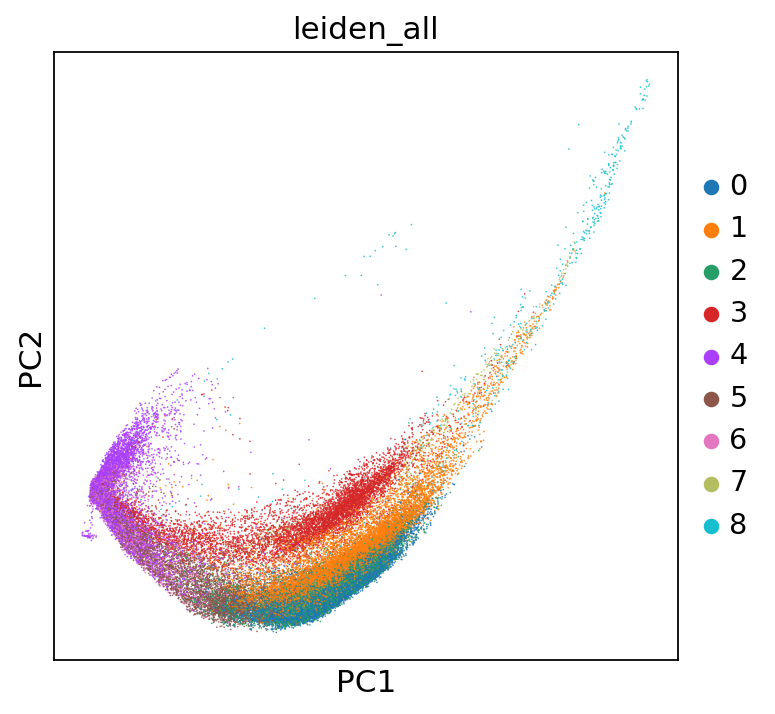

In [22]:
#adata_metab.obs['louvain_all'] = adata.obs['louvain']
sc.set_figure_params(figsize=(5, 5))
fig = sc.pl.pca(adata_metab, color='leiden_all', alpha=0.85)#, title='CD4+ cells clustered by all genes')

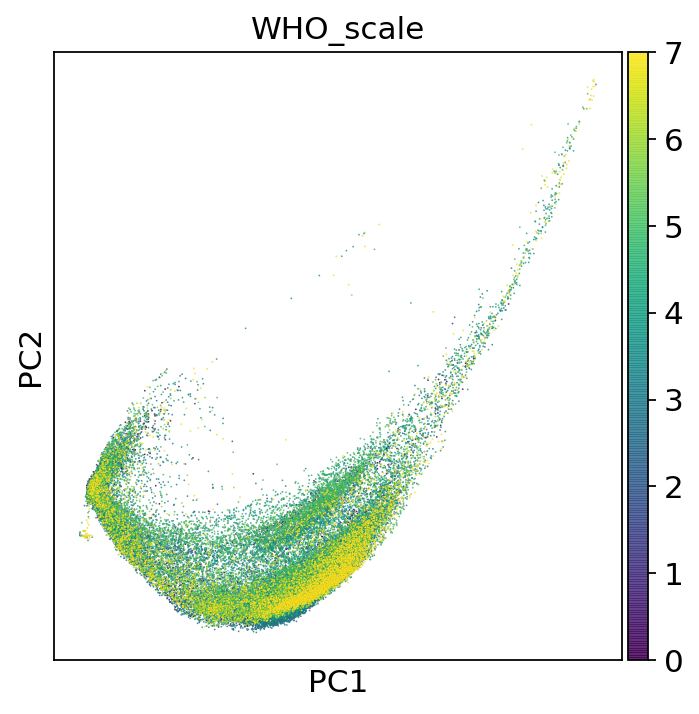

In [23]:
sc.set_figure_params(figsize=(5, 5))
fig = sc.pl.pca(adata_metab, color='WHO_scale', cmap='viridis', linewidth=0.01, edgecolor='black',
               alpha=0.85)#, title='CD4+ cells clustered by all genes')

### Expression of key metabolic regulator genes

In [26]:
spr_corr = ya.apply(lambda col: spearmanr(col, x.values)[0], axis=0)
spr_pvalues = ya.apply(lambda col: spearmanr(col, x.values)[1], axis=0)
spr_corr

louvain_metab
0   -0.388229
1    0.281022
2    0.169875
3    0.099718
4    0.019116
5    0.026152
6    0.161902
7   -0.022390
dtype: float64

In [27]:
spr_pvalues

louvain_metab
0    0.003110
1    0.035902
2    0.210688
3    0.464649
4    0.888788
5    0.848273
6    0.233214
7    0.869897
dtype: float64

/usr/lusers/jlee712/anaconda3/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


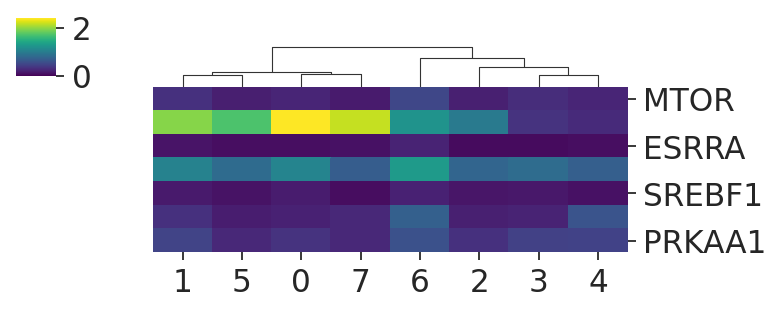

In [56]:
genes = ['MTOR', 'MYC', 'ESRRA', 'HIF1A', 'SREBF1', 'MAPK1', 'PRKAA1']
df = pd.DataFrame(columns=adata.obs['louvain_metab'].unique(), 
                  index=adata.var_names[np.where(adata.var_names.isin(genes))])
for col in df.columns:
    df[col] = np.mean(adata[adata.obs['louvain_metab']==col].X[:, 
              np.where(adata.var_names.isin(genes))], axis=0).flatten()
#df = (df.transpose() / np.sum(df, axis=1)).transpose()
df = pd.merge(pd.DataFrame(genes, index=genes), df, left_index=True, right_index=True)
df = df.drop(columns=0)
sns.clustermap(df, row_cluster=False, vmin=0, cmap='viridis', figsize=(5, 2))
#sns.heatmap(df)

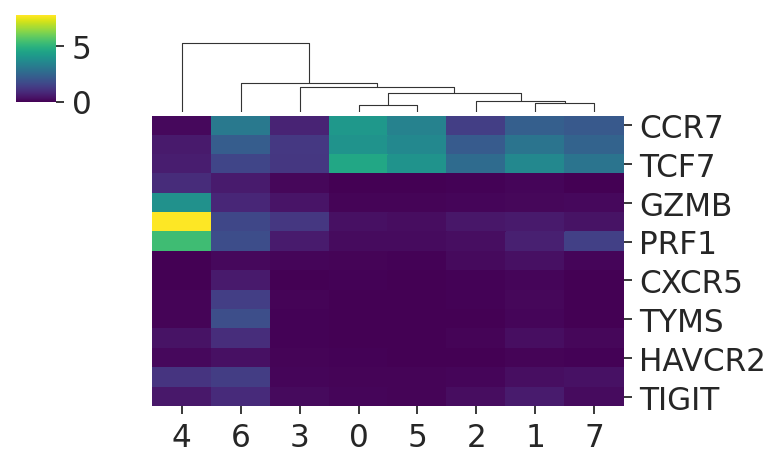

In [85]:
genes = ['CCR7', 'LEF1', 'TCF7', 'IFNG', 'GZMB', 'GNLY', 'PRF1', 'FOXP3', 'CXCR5', 
         'MKI67', 'TYMS', 'PDCD1', 'HAVCR2', 'LAG3', 'TIGIT']#, 'HLA-A', 'HLA-B', 'HLA-C']

df = pd.DataFrame(columns=adata.obs['louvain_metab'].unique(), 
                  index=adata.var_names[np.where(adata.var_names.isin(genes))])
for col in df.columns:
    df[col] = np.mean(adata[adata.obs['louvain_metab']==col].X[:, 
              np.where(adata.var_names.isin(genes))], axis=0).flatten()
#df = (df.transpose() / np.sum(df, axis=1)).transpose()
df = pd.merge(pd.DataFrame(genes, index=genes), df, left_index=True, right_index=True)
df = df.drop(columns=0)
sns.clustermap(df, row_cluster=False, vmin=0, cmap='viridis', figsize=(5, 3))
#sns.heatmap(df)

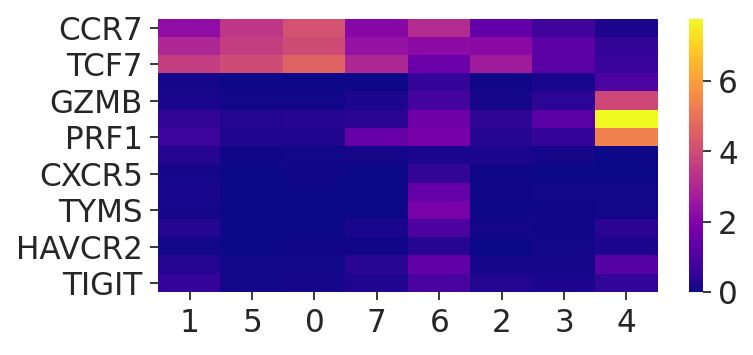

In [89]:
# Now plotting the same as above, but in the order of the metabolic clusters
df = pd.DataFrame(columns=adata.obs['louvain_metab'].unique(), 
                  index=adata.var_names[np.where(adata.var_names.isin(genes))])
df = df.loc[:, ['1', '5', '0', '7', '6', '2', '3', '4']]
for col in df.columns:
    df[col] = np.mean(adata[adata.obs['louvain_metab']==col].X[:, 
              np.where(adata.var_names.isin(genes))], axis=0).flatten()
#df = (df.transpose() / np.sum(df, axis=1)).transpose()
df = pd.merge(pd.DataFrame(genes, index=genes), df, left_index=True, right_index=True)
df = df.drop(columns=0)
fig = plt.figure(figsize=(5, 2.25))
fig = sns.heatmap(df, vmin=0, cmap='plasma')
#sns.heatmap(df)

In [70]:
# Overall cluster including subtype Treg
adata.obs['leiden_w_subtype'] = adata.obs['leiden'].copy()
adata.obs['leiden_w_subtype'] = adata.obs['leiden_w_subtype'].astype(str)

adata.obs.iloc[np.where((adata.obs['subtype']=='Treg') * (adata.obs['leiden']=='1'))[0], 
               adata.obs.columns.get_loc('leiden_w_subtype')] = \
    adata.obs.iloc[np.where((adata.obs['subtype']=='Treg') * (adata.obs['leiden']=='1'))[0], 
                   adata.obs.columns.get_loc('leiden_w_subtype')].astype(str) + 'Treg'

adata_metab.obs['leiden_w_subtype'] = adata.obs['leiden_w_subtype'].copy()

/home/jwlee/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  warnings.warn(


### Save pseudobulk expression data for each metabolic cluster

In [97]:
# Generate pseudobulk expression data for each metabolic cluster
clusters = list(adata.obs['louvain_metab'].unique())
clusters.sort()
df = pd.DataFrame(columns=clusters, index=adata.var_names)
for cluster in clusters:
    df[cluster] = np.nanmean(adata[adata.obs['louvain_metab']==cluster].X, axis=0)

# Save as a compressed file
# Saving as Excel consumes too much memory
df.to_csv(master_dir + 'output/' + celltype + '-metab_cluster-pseudobulk.csv.gz', compression='gzip')

... storing 'leiden_w_subtype' as categorical


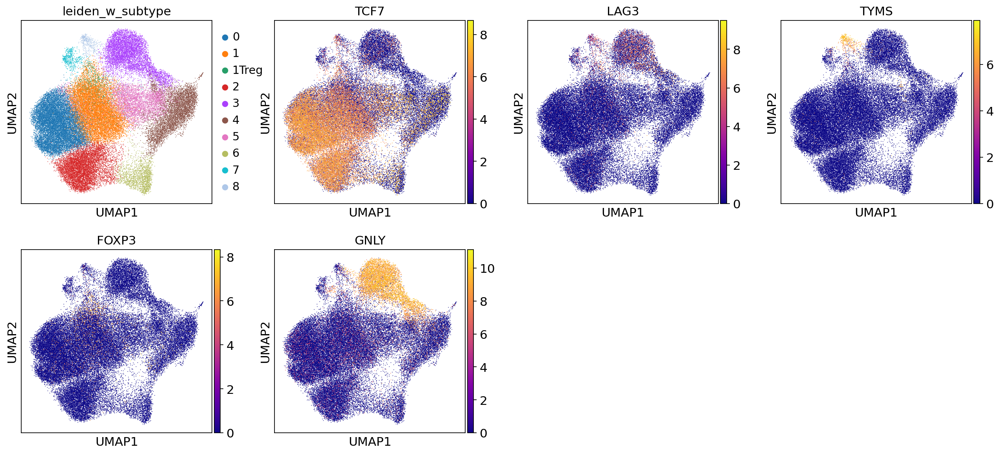

In [63]:
sc.pl.umap(adata, color=['leiden_w_subtype', 'TCF7', 'LAG3', 'TYMS', 'FOXP3', 'GNLY'], cmap='plasma')

... storing 'leiden_w_subtype' as categorical


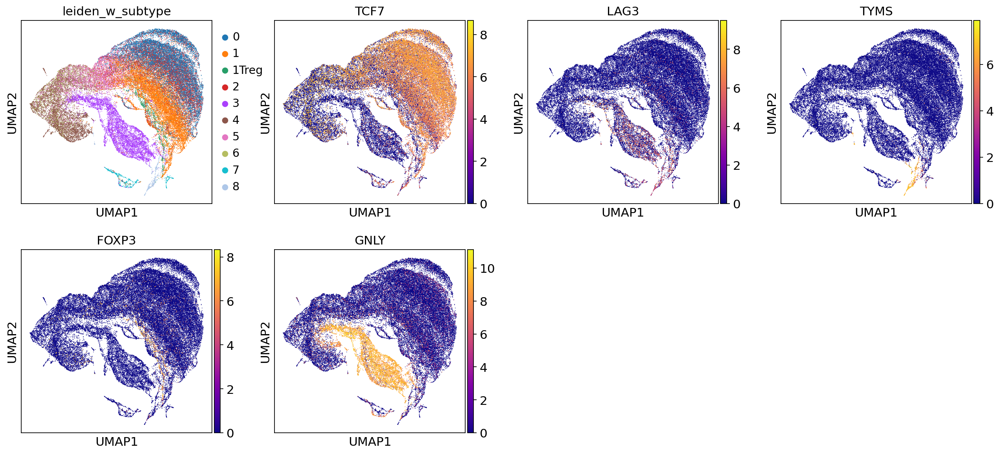

In [64]:
sc.pl.umap(adata_metab, color=['leiden_w_subtype', 'TCF7', 'LAG3', 'TYMS', 'FOXP3', 'GNLY'], cmap='plasma')

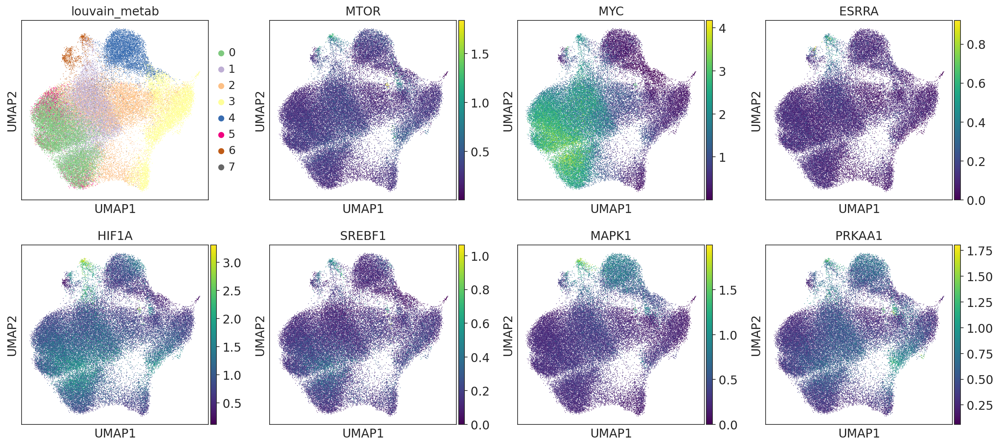

In [78]:
sc.pl.umap(adata, color=['louvain_metab', 'MTOR', 'MYC', 'ESRRA', 'HIF1A', 'SREBF1', 'MAPK1', 'PRKAA1'], cmap='viridis',
          use_raw=False)

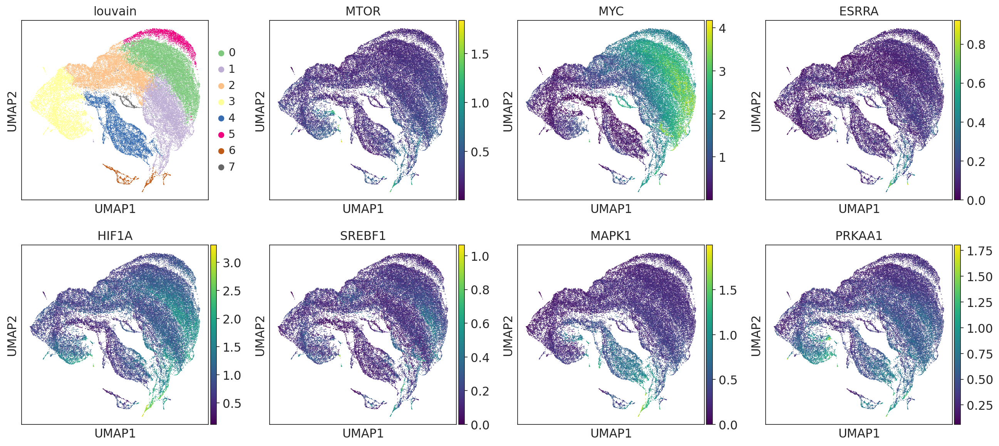

In [76]:
sc.pl.umap(adata_metab_all_genes, color=['louvain', 'MTOR', 'MYC', 'ESRRA', 'HIF1A', 'SREBF1', 'MAPK1', 'PRKAA1'], cmap='viridis',
          use_raw=False)

In [63]:
plot_bar(adata, 'leiden_w_subtype', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters',
         )

### Plotting metabolic genes

... storing 'severity' as categorical
... storing 'leiden_w_subtype' as categorical


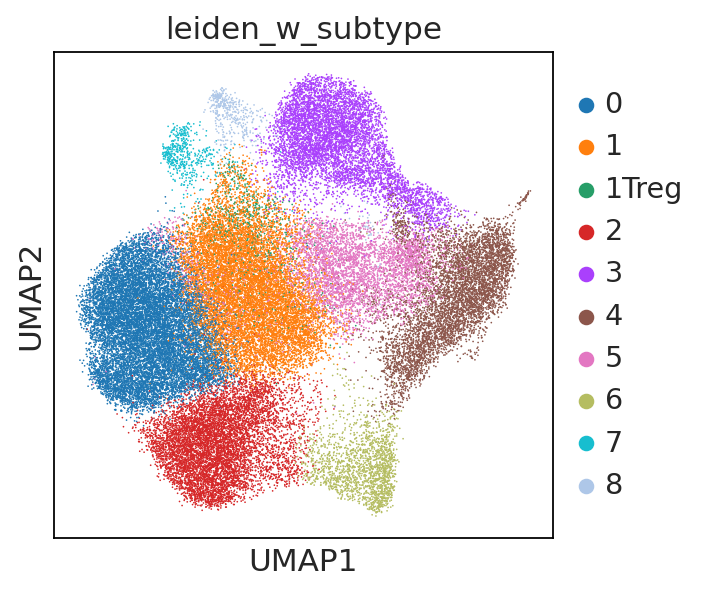

In [71]:
sc.pl.umap(adata, color='leiden_w_subtype')

In [171]:
# T cell functional markers
pathway_name = 'Fatty acid degradation'
gene = metab_genes_dict[pathway_name]

adata_healthy = adata[adata.obs['severity']=='Mild/healthy']
adata_nonICU = adata[adata.obs['severity']=='Moderate']
adata_ICU = adata[adata.obs['severity']=='Severe']

In [172]:
# Compare the single-cell clusters with patient pseodobulk
# All clusters
#f, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True, sharey=True)

#gene = ['LDHA', 'LDHB', 'LDHC']
adata_pseudobulk_all = adata.copy()
adata_pseudobulk_all.obs['gene'] = np.mean(adata_pseudobulk_all.X[:, 
                    np.where(adata.var_names.isin(gene))].reshape([len(adata_pseudobulk_all), len(gene)]), axis=1)
adata_pseudobulk_obs_all = adata_pseudobulk_all.obs.groupby('patient').mean()
adata_pseudobulk_obs_all = pd.merge(adata_pseudobulk_obs_all, 
                    adata_pseudobulk_all.obs.groupby('patient').first().loc[:, ['severity']], on='patient', how='left')

#f = sns.boxplot(x=adata_pseudobulk_obs['ICU_status'], 
#               y=adata_pseudobulk_obs['gene'])#, ax=axes[0])
#f = plt.xlabel('ICU status')
#f = plt.ylabel(pathway_name)

In [173]:
# Compare the single-cell clusters with patient bulk (combining only the effectors: clusters 0, 2, 8)
#f, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True, sharey=True)

#gene = ['LDHA', 'LDHB', 'LDHC']
#adata_pseudobulk = adata.copy()
#adata_pseudobulk_6 = adata_pseudobulk[adata_pseudobulk.obs['louvain_metab'].isin(['6'])].copy()
#adata_pseudobulk_4 = adata_pseudobulk[adata_pseudobulk.obs['louvain_metab'].isin(['4'])].copy()
#adata_pseudobulk_Treg = adata_pseudobulk[adata_pseudobulk.obs['subtype'].isin(['Treg'])].copy()

def process_pseudobulk(input_pseudobulk):
    input_pseudobulk.obs['gene'] = np.mean(input_pseudobulk.X[:, 
                    np.where(adata.var_names.isin(gene))].reshape([len(input_pseudobulk), len(gene)]), axis=1)
    input_pseudobulk_obs = input_pseudobulk.obs.groupby('patient').mean()
    input_pseudobulk_obs = pd.merge(input_pseudobulk_obs, 
                    input_pseudobulk.obs.groupby('patient').first().loc[:, ['severity']], on='patient', how='left')
    return input_pseudobulk_obs

#adata_pseudobulk_obs = adata_pseudobulk
#adata_pseudobulk_6_obs = process_pseudobulk(adata_pseudobulk_6)
#adata_pseudobulk_4_obs = process_pseudobulk(adata_pseudobulk_4)
#adata_pseudobulk_Treg_obs = process_pseudobulk(adata_pseudobulk_Treg)

#f = sns.boxplot(x=adata_pseudobulk_obs['ICU_status'], 
#               y=adata_pseudobulk_obs['gene'])#, ax=axes[0])
#f = plt.xlabel('ICU status')
#f = plt.ylabel(pathway_name)

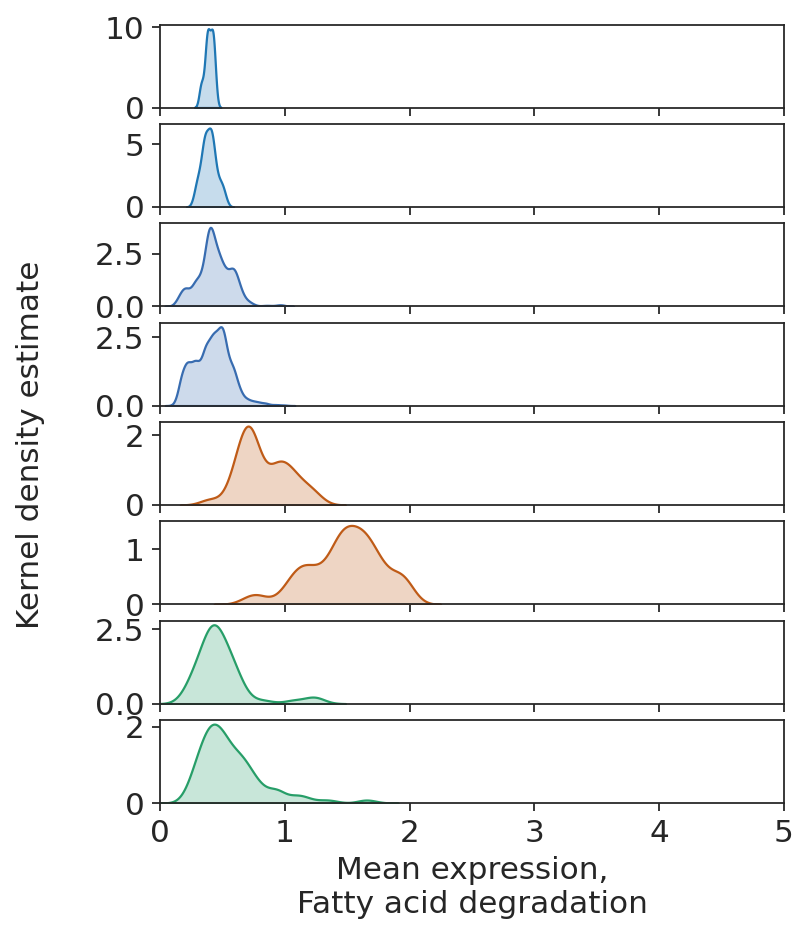

In [174]:
f, axes = plt.subplots(8, 1, figsize=(5, 4*8/5), sharex=True, sharey=False)
sns.set_style('ticks')
#f, axes = plt.subplots(8, 1, figsize=(3, 4*8/5), sharex=True, sharey=False)
f.text(0.0, 0.5, 'Kernel density estimate', va='center', rotation='vertical')
f = plt.xlabel('Mean expression,\n' + pathway_name)
f = plt.xlim((0, 5))
#f = plt.yticks([0, 5])

bins = np.arange(0, 2.5, 0.01)
bw = 0.8
f = sns.kdeplot(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'], 
                shade=True, ax=axes[0], legend=None, bw_adjust=bw)
axes[0].set_ylabel('') 
f = sns.kdeplot(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'], 
                shade=True, ax=axes[1], legend=None, bw_adjust=bw)
axes[1].set_ylabel('') 

f = sns.kdeplot(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
                color=adata.uns['louvain_metab_colors'][4], shade=True, ax=axes[2], legend=None, bw_adjust=bw)
axes[2].set_ylabel('') 
f = sns.kdeplot(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
                color=adata.uns['louvain_metab_colors'][4], shade=True, ax=axes[3], legend=None, bw_adjust=bw)
axes[3].set_ylabel('') 

f = sns.kdeplot(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1),
                color=adata.uns['louvain_metab_colors'][6], shade=True, ax=axes[4], legend=None, bw_adjust=bw)
axes[4].set_ylabel('') 
f = sns.kdeplot(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1),
                color=adata.uns['louvain_metab_colors'][6], shade=True, ax=axes[5], legend=None, bw_adjust=bw)
axes[5].set_ylabel('') 

f = sns.kdeplot(np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1),
                color=adata.uns['leiden_w_subtype_colors'][2], shade=True, ax=axes[6], legend=None, bw_adjust=bw)
axes[6].set_ylabel('') 
f = sns.kdeplot(np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1),
                color=adata.uns['leiden_w_subtype_colors'][2], shade=True, ax=axes[7], legend=None, bw_adjust=bw)
axes[7].set_ylabel('') 

plt.grid(False)
#plt.savefig(master_dir + 'output/cd4-Oxidative_phosphorylation-GEX-by_severity.pdf')

In [175]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'],
adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'])

MannwhitneyuResult(statistic=80.0, pvalue=0.4321973899228302)

In [176]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'],
 np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=1450.0, pvalue=0.10753431942407243)

In [177]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'],
 np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=9019.0, pvalue=0.22304564862361992)

In [178]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'],
 np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=3.0, pvalue=1.1823529494786723e-05)

In [179]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'],
 np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=0.0, pvalue=9.314730724336971e-07)

In [180]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'],
np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=121.0, pvalue=0.04939660495724825)

In [181]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Mild/healthy']['gene'],
np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=852.0, pvalue=0.007584178810904081)

In [182]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'],
 np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=3882.0, pvalue=0.030809504613903006)

In [183]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'],
 np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=24014.0, pvalue=0.1279452648647667)

In [184]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'],
 np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=10.0, pvalue=1.2468965918024084e-09)

In [185]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'],
 np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=0.0, pvalue=4.450795260612812e-14)

In [186]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'],
 np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=327.0, pvalue=0.010674952144478599)

In [187]:
mannwhitneyu(adata_pseudobulk_obs_all[adata_pseudobulk_obs_all['severity']=='Severe']['gene'],
 np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=2237.0, pvalue=5.276415408935657e-05)

In [188]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=606350.0, pvalue=0.008660823570104807)

In [189]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=623.0, pvalue=3.550122756653712e-19)

In [190]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=45.0, pvalue=9.355387958418946e-83)

In [191]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=10431.0, pvalue=0.10941192037354014)

In [192]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=71792.0, pvalue=3.187677605886539e-16)

In [193]:
mannwhitneyu(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=3362.0, pvalue=3.3377895406911805e-20)

In [194]:
mannwhitneyu(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=355.0, pvalue=6.537880689768935e-104)

In [195]:
mannwhitneyu(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=53323.0, pvalue=0.022760696479061846)

In [196]:
mannwhitneyu(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='4')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='4'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=364787.5, pvalue=2.480976023617319e-33)

In [197]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=229.0, pvalue=4.981195509452782e-17)

In [198]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1),
             np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=154.5, pvalue=4.5981007561110823e-10)

In [199]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=2574.0, pvalue=6.130771568682487e-10)

In [200]:
mannwhitneyu(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1),
             np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=94.0, pvalue=3.743884481542484e-25)

In [201]:
mannwhitneyu(np.mean(adata_ICU.X[np.where(adata_ICU.obs['louvain_metab']=='6')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['louvain_metab']=='6'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=1694.5, pvalue=7.332241485764099e-73)

In [202]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['subtype']=='Treg'), len(gene)]),
                    axis=1),
             np.mean(adata_ICU.X[np.where(adata_ICU.obs['subtype']=='Treg')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['subtype']=='Treg'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=8123.0, pvalue=0.009231868102581989)

### TCR clonality

In [84]:
adata_tcr = sc.read_h5ad(master_dir + 'data/PBMC/TCR/upto_tenth8_t1t2h_rev_P_GE_int_tcr_cd4_t_cells.h5ad')

In [85]:
adata_tcr.obs_names

Index(['AAACGGGAGGCAATTA-1-1:Mix:Mix_donor1',
       'AAACGGGGTATAAACG-1-1:Mix:Mix_donor1',
       'AAACGGGGTCAAAGCG-1-1:Mix:Mix_donor1',
       'AAAGCAAAGTAGGTGC-1-1:Mix:Mix_donor1',
       'AAATGCCAGATGCCTT-1-1:Mix:Mix_donor1',
       'AAATGCCGTACCCAAT-1-1:Mix:Mix_donor1',
       'AACACGTGTGAAATCA-1-1:Mix:Mix_donor1',
       'AACCATGTCGAGCCCA-1-1:Mix:Mix_donor1',
       'AACCATGTCGCATGGC-1-1:Mix:Mix_donor1',
       'AACCATGTCTAACTTC-1-1:Mix:Mix_donor1',
       ...
       'TTCGAAGGTGAAATCA-1-10:J1:104-1', 'TTCTACACACCACCAG-1-10:J1:104-1',
       'TTCTCCTAGTTTAGGA-1-10:J1:104-1', 'TTCTCCTTCTTGAGGT-1-10:J1:104-1',
       'TTGCCGTGTCACCCAG-1-10:J1:104-1', 'TTTACTGCAAGCCTAT-1-10:J1:104-1',
       'TTTCCTCCACCGAATT-1-10:J1:104-1', 'TTTCCTCGTGCGCTTG-1-10:J1:104-1',
       'TTTGCGCCACTTCGAA-1-10:J1:104-1', 'TTTGTCACATCCTTGC-1-10:J1:104-1'],
      dtype='object', name='cell_id', length=141012)

In [86]:
adata_tcr.obs['temp_name'] = (pd.Series(adata_tcr.obs_names).apply(lambda x: x.split('-')[0]) + '-' + \
                                pd.Series(adata_tcr.obs_names).apply(lambda x: x.split(':')[-1])).tolist()
adata_tcr_obs_uniques = adata_tcr.obs.drop_duplicates(subset='temp_name').set_index('temp_name')
adata_tcr.obs['temp_name']

cell_id
AAACGGGAGGCAATTA-1-1:Mix:Mix_donor1    AAACGGGAGGCAATTA-Mix_donor1
AAACGGGGTATAAACG-1-1:Mix:Mix_donor1    AAACGGGGTATAAACG-Mix_donor1
AAACGGGGTCAAAGCG-1-1:Mix:Mix_donor1    AAACGGGGTCAAAGCG-Mix_donor1
AAAGCAAAGTAGGTGC-1-1:Mix:Mix_donor1    AAAGCAAAGTAGGTGC-Mix_donor1
AAATGCCAGATGCCTT-1-1:Mix:Mix_donor1    AAATGCCAGATGCCTT-Mix_donor1
                                                  ...             
TTTACTGCAAGCCTAT-1-10:J1:104-1              TTTACTGCAAGCCTAT-104-1
TTTCCTCCACCGAATT-1-10:J1:104-1              TTTCCTCCACCGAATT-104-1
TTTCCTCGTGCGCTTG-1-10:J1:104-1              TTTCCTCGTGCGCTTG-104-1
TTTGCGCCACTTCGAA-1-10:J1:104-1              TTTGCGCCACTTCGAA-104-1
TTTGTCACATCCTTGC-1-10:J1:104-1              TTTGTCACATCCTTGC-104-1
Name: temp_name, Length: 141012, dtype: object

In [88]:
adata_metab.obs['temp_name'] = [x.split('-')[0] + '-' + x.split('-')[-2] + '-' + \
                               x.split('-')[-1] if len(x.split('-')[-1])==1 \
                                else x.split('-')[0] + '-' + x.split('-')[-1] for x in adata_metab.obs_names]
adata_metab.obs['temp_name'] = [x.split(':')[0].split('-')[0] + \
                                '-' + x.split(':')[-1] if ':' in x \
                                else x for x in adata_metab.obs['temp_name']]
adata_metab.obs['temp_name'] = adata_metab.obs['temp_name'].apply(lambda x: x.split('-')[0] + '-Mix_donor1' \
                                                                  if x.split('-')[-1]=='Mix' else x)
adata_metab.obs['temp_name']

AAACCTGTCGGTCTAA-1-Mix        AAACCTGTCGGTCTAA-Mix_donor1
AAACGGGAGGCAATTA-1-Mix        AAACGGGAGGCAATTA-Mix_donor1
AAACGGGGTATAAACG-1-Mix        AAACGGGGTATAAACG-Mix_donor1
AAACGGGGTCAAAGCG-1-Mix        AAACGGGGTCAAAGCG-Mix_donor1
AAACGGGTCAACGGCC-1-Mix        AAACGGGTCAACGGCC-Mix_donor1
                                         ...             
TTTATGCGTTCGAATC-1-C6:36-1          TTTATGCGTTCGAATC-36-1
TTTCCTCAGTGCCATT-1-C6:36-1          TTTCCTCAGTGCCATT-36-1
TTTGGTTAGGGATCTG-1-C6:36-1          TTTGGTTAGGGATCTG-36-1
TTTGTCAAGGGTCTCC-1-C6:36-1          TTTGTCAAGGGTCTCC-36-1
TTTGTCAGTGTGCGTC-1-C6:36-1          TTTGTCAGTGTGCGTC-36-1
Name: temp_name, Length: 52261, dtype: object

In [89]:
len(adata_metab.obs['temp_name'].unique())

52259

In [90]:
len(adata_metab)

52261

... storing 'temp_name' as categorical
... storing 'multi_chain' as categorical


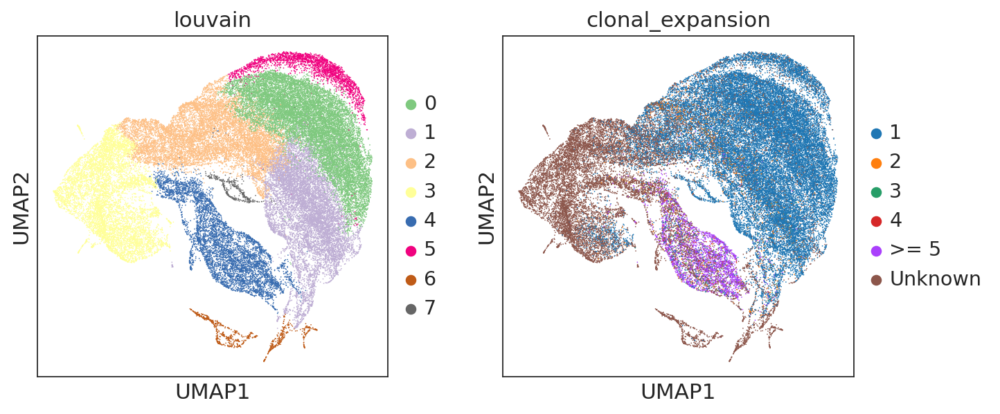

In [91]:
adata_metab_tcr = adata_metab.copy()
#adata_metab_tcr = adata_metab_tcr[adata_metab_tcr.obs.drop_duplicates(subset='temp_name').index]

adata_metab_tcr.obs = pd.merge(adata_metab.obs, adata_tcr_obs_uniques, left_on='temp_name', right_index=True,
                           how='left')#, validate='1:1')
#adata_metab_tcr = adata_metab[adata_metab_obs_temp.index]
adata_metab_tcr.obs['clonal_expansion'] = adata_metab_tcr.obs['clonal_expansion'].cat.add_categories('Unknown')

adata_metab_tcr.obs['clonal_expansion'] = adata_metab_tcr.obs['clonal_expansion'].fillna('Unknown')
sc.pl.umap(adata_metab_tcr, color=['louvain', 'clonal_expansion'])

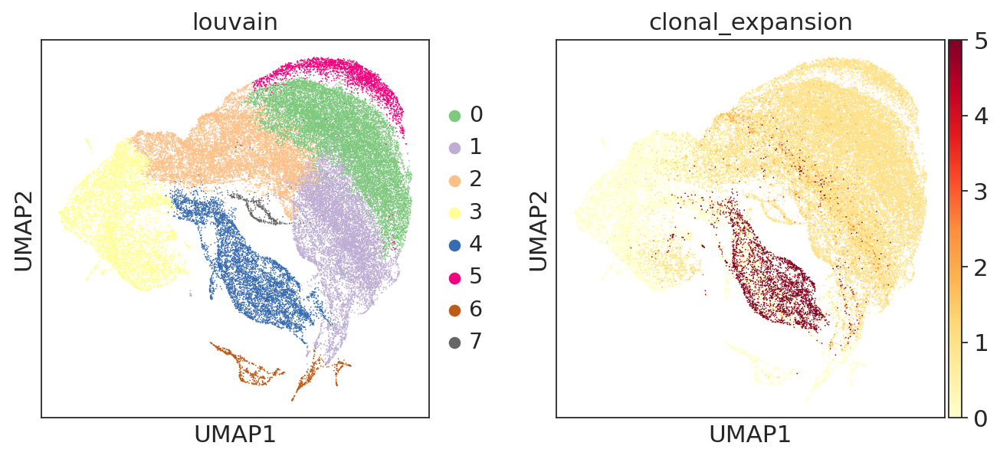

In [101]:
#import matplotlib
#cmap = matplotlib.cm.get_cmap('YlOrRd', 5)(range(5))
#hex_cmap = []
#for c in cmap:
#    hex_cmap.append(matplotlib.colors.rgb2hex(c))#
#
#hex_cmap.extend(['#bbbbbb'])

adata_metab_tcr.obs['clonal_expansion'] = adata_metab_tcr.obs['clonal_expansion'].map({'1': 1, '2': 2, 
                                                '3': 3, '4': 4, '>= 5': 5, 'Unknown': 0}).astype(int)
#adata_metab_tcr.uns['clonal_expansion_colors'] = hex_cmap
sc.pl.umap(adata_metab_tcr, color=['louvain', 'clonal_expansion'], cmap='YlOrRd')

In [102]:
plot_bar(adata_metab_tcr, 'clonal_expansion', 'louvain', 
         adata_metab_tcr.obs, 'Frequency', 'output/' + celltype + '-TCR_expansion')

In [105]:
# Save TCR data for cluster 6 cells
adata_metab_tcr.obs[adata_metab_tcr.obs['louvain']=='6'][['patient_x', 'WHO_scale', 'louvain', 
           'Blood_draw_time', 'Days_since_onset_float', 'multi_chain',
           'TRA_1_cdr3', 'TRA_2_cdr3', 'TRB_1_cdr3', 'TRB_2_cdr3',
           'TRA_1_junction_ins', 'TRA_2_junction_ins', 'TRB_1_junction_ins',
           'TRB_2_junction_ins', 'TRA_1_expr', 'TRA_2_expr', 'TRB_1_expr',
           'TRB_2_expr', 'TRA_1_v_gene', 'TRA_2_v_gene', 'TRB_1_v_gene',
           'TRB_2_v_gene', 'TRA_1_d_gene', 'TRA_2_d_gene', 'TRB_1_d_gene',
           'TRB_2_d_gene', 'TRA_1_j_gene', 'TRA_2_j_gene', 'TRB_1_j_gene',
           'TRB_2_j_gene', 'TRA_1_c_gene', 'TRA_2_c_gene', 'TRB_1_c_gene',
           'TRB_2_c_gene', 'TRA_1_cdr3_nt', 'TRA_2_cdr3_nt', 'TRB_1_cdr3_nt',
           'TRB_2_cdr3_nt', 'has_tcr', 'chain_pairing', 'clonotype',
           'clonotype_size', 'clonal_expansion']].to_excel(master_dir + 'output/' + celltype +
                           '-TCR_expansion/' + celltype + '-metab_cluster_6-TCR.xlsx')